In [299]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import joblib

In [160]:
df_energy = pd.read_csv('../data/energy_dataset.csv')
df_weather = pd.read_csv('../data/weather_features.csv')

In [161]:
df_energy.head()

,time,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,...,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
0,2015-01-01 00:00:00+01:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,...,196.0,0.0,6378.0,17.0,NaN,6436.0,26118.0,25385.0,50.10,65.41
1,2015-01-01 01:00:00+01:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,...,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2,2015-01-01 02:00:00+01:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,...,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48
3,2015-01-01 03:00:00+01:00,438.0,254.0,0.0,4314.0,4131.0,160.0,0.0,0.0,0.0,...,191.0,0.0,5238.0,2.0,NaN,5151.0,22642.0,21286.0,42.27,59.32
4,2015-01-01 04:00:00+01:00,428.0,187.0,0.0,4130.0,3840.0,156.0,0.0,0.0,0.0,...,189.0,0.0,4935.0,9.0,NaN,4861.0,21785.0,20264.0,38.41,56.04


In [162]:
df_weather.head()

,dt_iso,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,2015-01-01 00:00:00+01:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
1,2015-01-01 01:00:00+01:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
2,2015-01-01 02:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
3,2015-01-01 03:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
4,2015-01-01 04:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n


In [163]:
df_energy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35064 entries, 0 to 35063
Data columns (total 29 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   time                                         35064 non-null  object 
 1   generation biomass                           35045 non-null  float64
 2   generation fossil brown coal/lignite         35046 non-null  float64
 3   generation fossil coal-derived gas           35046 non-null  float64
 4   generation fossil gas                        35046 non-null  float64
 5   generation fossil hard coal                  35046 non-null  float64
 6   generation fossil oil                        35045 non-null  float64
 7   generation fossil oil shale                  35046 non-null  float64
 8   generation fossil peat                       35046 non-null  float64
 9   generation geothermal                        35046 non-null  float64
 10

In [164]:
df_weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 178396 entries, 0 to 178395
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   dt_iso               178396 non-null  object 
 1   city_name            178396 non-null  object 
 2   temp                 178396 non-null  float64
 3   temp_min             178396 non-null  float64
 4   temp_max             178396 non-null  float64
 5   pressure             178396 non-null  int64  
 6   humidity             178396 non-null  int64  
 7   wind_speed           178396 non-null  int64  
 8   wind_deg             178396 non-null  int64  
 9   rain_1h              178396 non-null  float64
 10  rain_3h              178396 non-null  float64
 11  snow_3h              178396 non-null  float64
 12  clouds_all           178396 non-null  int64  
 13  weather_id           178396 non-null  int64  
 14  weather_main         178396 non-null  object 
 15  weather_descripti

In [165]:
df_weather.describe()

,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id
count,178396.000000,178396.000000,178396.000000,1.783960e+05,178396.000000,178396.00000,178396.000000,178396.000000,178396.000000,178396.000000,178396.000000,178396.000000
mean,289.618605,288.330442,291.091267,1.069261e+03,68.423457,2.47056,166.591190,0.075492,0.000380,0.004763,25.073292,759.831902
std,8.026199,7.955491,8.612454,5.969632e+03,21.902888,2.09591,116.611927,0.398847,0.007288,0.222604,30.774129,108.733223
min,262.240000,262.240000,262.240000,0.000000e+00,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,200.000000
25%,283.670000,282.483602,284.650000,1.013000e+03,53.000000,1.00000,55.000000,0.000000,0.000000,0.000000,0.000000,800.000000
50%,289.150000,288.150000,290.150000,1.018000e+03,72.000000,2.00000,177.000000,0.000000,0.000000,0.000000,20.000000,800.000000
75%,295.150000,293.730125,297.150000,1.022000e+03,87.000000,4.00000,270.000000,0.000000,0.000000,0.000000,40.000000,801.000000
max,315.600000,315.150000,321.150000,1.008371e+06,100.000000,133.00000,360.000000,12.000000,2.315000,21.500000,100.000000,804.000000


In [166]:
df_energy = df_energy.drop(['generation hydro pumped storage aggregated', 'forecast wind offshore eday ahead'], axis=1)

In [167]:
df_energy.isnull().sum()

time                                            0
generation biomass                             19
generation fossil brown coal/lignite           18
generation fossil coal-derived gas             18
generation fossil gas                          18
generation fossil hard coal                    18
generation fossil oil                          19
generation fossil oil shale                    18
generation fossil peat                         18
generation geothermal                          18
generation hydro pumped storage consumption    19
generation hydro run-of-river and poundage     19
generation hydro water reservoir               18
generation marine                              19
generation nuclear                             17
generation other                               18
generation other renewable                     18
generation solar                               18
generation waste                               19
generation wind offshore                       18


In [168]:
df_energy['time'] = pd.to_datetime(df_energy['time'], utc=True)

In [169]:
df_energy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35064 entries, 0 to 35063
Data columns (total 27 columns):
 #   Column                                       Non-Null Count  Dtype              
---  ------                                       --------------  -----              
 0   time                                         35064 non-null  datetime64[ns, UTC]
 1   generation biomass                           35045 non-null  float64            
 2   generation fossil brown coal/lignite         35046 non-null  float64            
 3   generation fossil coal-derived gas           35046 non-null  float64            
 4   generation fossil gas                        35046 non-null  float64            
 5   generation fossil hard coal                  35046 non-null  float64            
 6   generation fossil oil                        35045 non-null  float64            
 7   generation fossil oil shale                  35046 non-null  float64            
 8   generation fossil peat    

In [170]:
Q1 = df_energy['price actual'].quantile(0.25)
Q3 = df_energy['price actual'].quantile(0.75)
IQR = Q3 - Q1

limite_inferior = Q1 - 1.5 * IQR
limite_superior = Q3 + 1.5 * IQR

In [171]:
df_energy.loc[df_energy['price actual'] < limite_inferior, 'price actual'] = None
df_energy.loc[df_energy['price actual'] > limite_superior, 'price actual'] = None

In [172]:
df_energy['price actual'].isnull().sum()

np.int64(699)

In [173]:
cols_num = df_energy.select_dtypes(include='number').columns
df_energy[cols_num] = df_energy[cols_num].interpolate(method='linear')

In [174]:
df_energy.isnull().sum()

time                                           0
generation biomass                             0
generation fossil brown coal/lignite           0
generation fossil coal-derived gas             0
generation fossil gas                          0
generation fossil hard coal                    0
generation fossil oil                          0
generation fossil oil shale                    0
generation fossil peat                         0
generation geothermal                          0
generation hydro pumped storage consumption    0
generation hydro run-of-river and poundage     0
generation hydro water reservoir               0
generation marine                              0
generation nuclear                             0
generation other                               0
generation other renewable                     0
generation solar                               0
generation waste                               0
generation wind offshore                       0
generation wind onsh

In [175]:
df_energy.describe()

,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,generation hydro pumped storage consumption,...,generation solar,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
count,35064.000000,35064.000000,35064.0,35064.000000,35064.000000,35064.000000,35064.0,35064.0,35064.0,35064.000000,...,35064.000000,35064.000000,35064.0,35064.000000,35064.000000,35064.000000,35064.000000,35064.000000,35064.000000,35064.000000
mean,383.531343,448.094570,0.0,5622.700647,4256.531271,298.342417,0.0,0.0,0.0,475.582706,...,1432.818546,269.418692,0.0,5464.980450,1439.066735,5471.216689,28712.129962,28698.281385,49.874341,57.984783
std,85.346266,354.618269,0.0,2201.510984,1961.988937,52.519927,0.0,0.0,0.0,792.312704,...,1679.961733,50.218423,0.0,3213.586296,1677.703355,3176.312853,4594.100854,4575.828854,14.618900,13.730938
min,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,...,0.000000,0.000000,0.0,0.000000,0.000000,237.000000,18105.000000,18041.000000,2.060000,21.360000
25%,333.000000,0.000000,0.0,4126.000000,2527.000000,263.000000,0.0,0.0,0.0,0.000000,...,71.000000,240.000000,0.0,2933.000000,69.000000,2979.000000,24793.750000,24807.000000,41.490000,49.347500
50%,367.000000,509.000000,0.0,4969.500000,4475.000000,300.000000,0.0,0.0,0.0,68.000000,...,616.000000,279.000000,0.0,4849.500000,576.000000,4855.000000,28906.000000,28902.000000,50.520000,58.020000
75%,433.000000,757.000000,0.0,6429.000000,5839.000000,330.000000,0.0,0.0,0.0,616.000000,...,2579.000000,310.000000,0.0,7399.500000,2636.000000,7353.000000,32263.250000,32194.250000,60.530000,68.010000
max,592.000000,999.000000,0.0,20034.000000,8359.000000,449.000000,0.0,0.0,0.0,4523.000000,...,5792.000000,357.000000,0.0,17436.000000,5836.000000,17430.000000,41390.000000,41015.000000,101.990000,95.950000


In [176]:
df_weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 178396 entries, 0 to 178395
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   dt_iso               178396 non-null  object 
 1   city_name            178396 non-null  object 
 2   temp                 178396 non-null  float64
 3   temp_min             178396 non-null  float64
 4   temp_max             178396 non-null  float64
 5   pressure             178396 non-null  int64  
 6   humidity             178396 non-null  int64  
 7   wind_speed           178396 non-null  int64  
 8   wind_deg             178396 non-null  int64  
 9   rain_1h              178396 non-null  float64
 10  rain_3h              178396 non-null  float64
 11  snow_3h              178396 non-null  float64
 12  clouds_all           178396 non-null  int64  
 13  weather_id           178396 non-null  int64  
 14  weather_main         178396 non-null  object 
 15  weather_descripti

In [177]:
df_weather.duplicated().sum()

np.int64(21)

In [178]:
duplicated = df_weather.duplicated(keep=False)
duplicated_rows = df_weather[duplicated]

In [179]:
duplicated_rows.sort_values(by = 'dt_iso')

,dt_iso,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
124,2015-01-06 04:00:00+01:00,Valencia,273.142,273.142,273.142,995,86,1,265,0.0,0.000,0.0,0,800,clear,sky is clear,01n
125,2015-01-06 04:00:00+01:00,Valencia,273.142,273.142,273.142,995,86,1,265,0.0,0.000,0.0,0,800,clear,sky is clear,01n
113961,2015-10-01 02:00:00+02:00,Barcelona,288.680,284.820,290.930,1020,67,3,340,0.0,0.000,0.0,20,801,clouds,few clouds,02n
113962,2015-10-01 02:00:00+02:00,Barcelona,288.680,284.820,290.930,1020,67,3,340,0.0,0.000,0.0,20,801,clouds,few clouds,02n
41710,2015-10-01 02:00:00+02:00,Madrid,286.750,285.930,287.150,1021,62,1,10,0.0,0.000,0.0,0,800,clear,sky is clear,01n
41709,2015-10-01 02:00:00+02:00,Madrid,286.750,285.930,287.150,1021,62,1,10,0.0,0.000,0.0,0,800,clear,sky is clear,01n
78025,2015-10-01 02:00:00+02:00,Bilbao,285.990,282.150,288.150,1021,87,1,0,0.0,0.000,0.0,0,800,clear,sky is clear,01n
78024,2015-10-01 02:00:00+02:00,Bilbao,285.990,282.150,288.150,1021,87,1,0,0.0,0.000,0.0,0,800,clear,sky is clear,01n
149409,2015-10-01 02:00:00+02:00,Seville,295.500,291.150,302.150,1019,63,0,0,0.0,0.000,0.0,0,800,clear,sky is clear,01n
6566,2015-10-01 02:00:00+02:00,Valencia,289.740,286.480,292.040,1021,88,0,0,0.0,0.000,0.0,40,802,clouds,scattered clouds,03n


In [180]:
data_weather_clear = df_weather.drop_duplicates()

In [181]:
data_weather_clear.shape

(178375, 17)

In [182]:
data_weather_clear.info()

<class 'pandas.core.frame.DataFrame'>
Index: 178375 entries, 0 to 178395
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   dt_iso               178375 non-null  object 
 1   city_name            178375 non-null  object 
 2   temp                 178375 non-null  float64
 3   temp_min             178375 non-null  float64
 4   temp_max             178375 non-null  float64
 5   pressure             178375 non-null  int64  
 6   humidity             178375 non-null  int64  
 7   wind_speed           178375 non-null  int64  
 8   wind_deg             178375 non-null  int64  
 9   rain_1h              178375 non-null  float64
 10  rain_3h              178375 non-null  float64
 11  snow_3h              178375 non-null  float64
 12  clouds_all           178375 non-null  int64  
 13  weather_id           178375 non-null  int64  
 14  weather_main         178375 non-null  object 
 15  weather_description  1

In [183]:
df_energy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35064 entries, 0 to 35063
Data columns (total 27 columns):
 #   Column                                       Non-Null Count  Dtype              
---  ------                                       --------------  -----              
 0   time                                         35064 non-null  datetime64[ns, UTC]
 1   generation biomass                           35064 non-null  float64            
 2   generation fossil brown coal/lignite         35064 non-null  float64            
 3   generation fossil coal-derived gas           35064 non-null  float64            
 4   generation fossil gas                        35064 non-null  float64            
 5   generation fossil hard coal                  35064 non-null  float64            
 6   generation fossil oil                        35064 non-null  float64            
 7   generation fossil oil shale                  35064 non-null  float64            
 8   generation fossil peat    

In [184]:
df_energy.columns

Index(['time', 'generation biomass', 'generation fossil brown coal/lignite',
       'generation fossil coal-derived gas', 'generation fossil gas',
       'generation fossil hard coal', 'generation fossil oil',
       'generation fossil oil shale', 'generation fossil peat',
       'generation geothermal', 'generation hydro pumped storage consumption',
       'generation hydro run-of-river and poundage',
       'generation hydro water reservoir', 'generation marine',
       'generation nuclear', 'generation other', 'generation other renewable',
       'generation solar', 'generation waste', 'generation wind offshore',
       'generation wind onshore', 'forecast solar day ahead',
       'forecast wind onshore day ahead', 'total load forecast',
       'total load actual', 'price day ahead', 'price actual'],
      dtype='object')

In [185]:
print(df_energy['generation marine'].value_counts())
print(df_energy['generation fossil peat'].value_counts())
print(df_energy['generation fossil oil shale'].value_counts())
print(df_energy['generation geothermal'].value_counts())
print(df_energy['generation other'].value_counts())
print(df_energy['generation other renewable'].value_counts())

generation marine
0.0    35064
Name: count, dtype: int64
generation fossil peat
0.0    35064
Name: count, dtype: int64
generation fossil oil shale
0.0    35064
Name: count, dtype: int64
generation geothermal
0.0    35064
Name: count, dtype: int64
generation other
57.0     2288
56.0     2271
55.0     2183
58.0     2093
54.0     1775
         ... 
46.5        1
55.5        1
103.0       1
3.0         1
54.5        1
Name: count, Length: 112, dtype: int64
generation other renewable
94.000000    990
92.000000    982
99.000000    978
93.000000    961
96.000000    954
            ... 
45.000000      1
73.142857      1
72.714286      1
72.285714      1
4.000000       1
Name: count, Length: 87, dtype: int64


In [186]:
df_energy = df_energy.drop(['generation marine', 'generation fossil peat', 'generation fossil oil shale', 
                            'generation geothermal', 'generation other', 'generation other renewable', 'price day ahead',
                            'total load actual', 'generation biomass', 'generation waste', 'generation fossil coal-derived gas',
                            'generation fossil oil', 'generation hydro pumped storage consumption'], axis=1)

'''
Variáveis com risco de data leakage, baixa variabilidade ou redundância econômica foram removidas, 
mantendo apenas regressoras disponíveis no momento da previsão.
'''

'\nVariáveis com risco de data leakage, baixa variabilidade ou redundância econômica foram removidas, \nmantendo apenas regressoras disponíveis no momento da previsão.\n'

In [187]:
df_energy = df_energy.drop('generation wind offshore', axis=1)

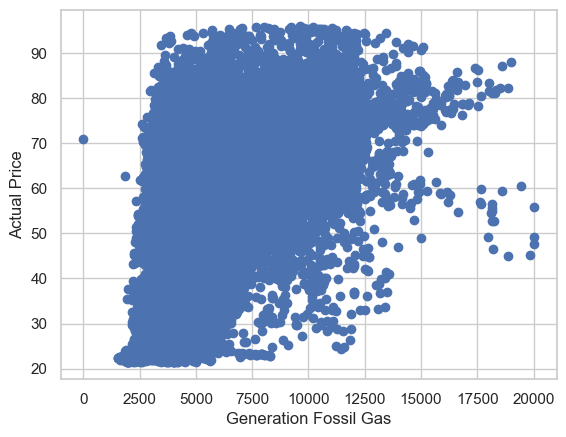

In [188]:
plt.scatter(df_energy['generation fossil gas'], df_energy['price actual'])
plt.xlabel('Generation Fossil Gas')
plt.ylabel('Actual Price')
plt.show()

In [189]:
df_energy[['generation fossil gas', 'price actual']].diff().corr()

,generation fossil gas,price actual
generation fossil gas,1.000000,0.427955
price actual,0.427955,1.000000


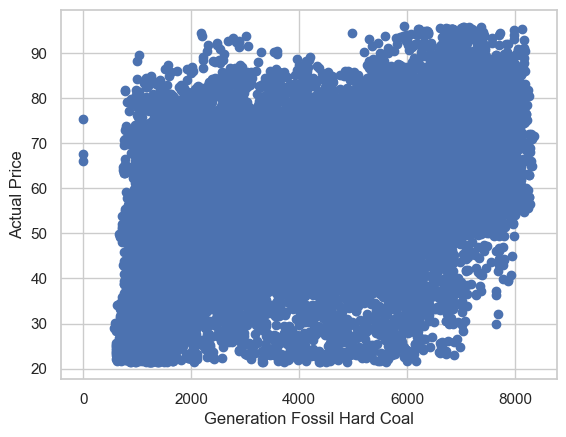

In [190]:
plt.scatter(df_energy['generation fossil hard coal'], df_energy['price actual'])
plt.xlabel('Generation Fossil Hard Coal')
plt.ylabel('Actual Price')
plt.show()

In [191]:
df_energy[['generation fossil hard coal', 'price actual']].diff().corr()

,generation fossil hard coal,price actual
generation fossil hard coal,1.000000,0.272359
price actual,0.272359,1.000000


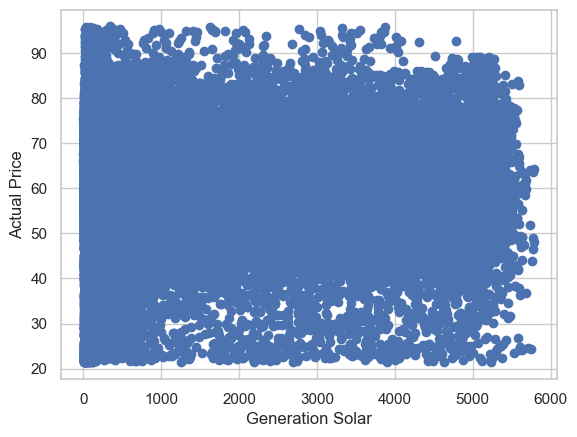

In [192]:
plt.scatter(df_energy['generation solar'], df_energy['price actual'])
plt.xlabel('Generation Solar')
plt.ylabel('Actual Price')
plt.show()

In [193]:
df_energy[['generation fossil brown coal/lignite', 'price actual']].diff().corr()

,generation fossil brown coal/lignite,price actual
generation fossil brown coal/lignite,1.00000,0.14211
price actual,0.14211,1.00000


In [194]:
df_energy.columns

Index(['time', 'generation fossil brown coal/lignite', 'generation fossil gas',
       'generation fossil hard coal',
       'generation hydro run-of-river and poundage',
       'generation hydro water reservoir', 'generation nuclear',
       'generation solar', 'generation wind onshore',
       'forecast solar day ahead', 'forecast wind onshore day ahead',
       'total load forecast', 'price actual'],
      dtype='object')

In [195]:
data_weather_clear.columns

Index(['dt_iso', 'city_name', 'temp', 'temp_min', 'temp_max', 'pressure',
       'humidity', 'wind_speed', 'wind_deg', 'rain_1h', 'rain_3h', 'snow_3h',
       'clouds_all', 'weather_id', 'weather_main', 'weather_description',
       'weather_icon'],
      dtype='object')

In [196]:
data_weather_clear['dt_iso'] = pd.to_datetime(data_weather_clear['dt_iso'], utc=True)

C:\Users\gui-s\AppData\Local\Temp\ipykernel_6960\1824028049.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [197]:
data_weather_clear

,dt_iso,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,2014-12-31 23:00:00+00:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
1,2015-01-01 00:00:00+00:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
2,2015-01-01 01:00:00+00:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
3,2015-01-01 02:00:00+00:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
4,2015-01-01 03:00:00+00:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178391,2018-12-31 18:00:00+00:00,Seville,287.760,287.150,288.150,1028,54,3,30,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178392,2018-12-31 19:00:00+00:00,Seville,285.760,285.150,286.150,1029,62,3,30,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178393,2018-12-31 20:00:00+00:00,Seville,285.150,285.150,285.150,1028,58,4,50,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178394,2018-12-31 21:00:00+00:00,Seville,284.150,284.150,284.150,1029,57,4,60,0.0,0.0,0.0,0,800,clear,sky is clear,01n


In [198]:
data_weather_clear['rain_3h'].value_counts()

rain_3h
0.000    176521
0.010       214
0.005       187
0.015       128
0.025        74
          ...  
0.068         2
0.071         2
0.083         1
2.315         1
0.053         1
Name: count, Length: 89, dtype: int64

In [199]:
data_weather_clear = data_weather_clear.drop(['weather_description', 'weather_icon', 'snow_3h', 'wind_deg', 'weather_id', 'rain_3h', 'temp_min',
                                             'temp_max'], axis=1)


'''
Variáveis meteorológicas categóricas, redundantes ou com baixa variabilidade foram removidas, 
mantendo apenas atributos numéricos com potencial impacto indireto sobre a demanda e geração de energia.
'''

'\nVariáveis meteorológicas categóricas, redundantes ou com baixa variabilidade foram removidas, \nmantendo apenas atributos numéricos com potencial impacto indireto sobre a demanda e geração de energia.\n'

In [200]:
data_weather_clear

,dt_iso,city_name,temp,pressure,humidity,wind_speed,rain_1h,clouds_all,weather_main
0,2014-12-31 23:00:00+00:00,Valencia,270.475,1001,77,1,0.0,0,clear
1,2015-01-01 00:00:00+00:00,Valencia,270.475,1001,77,1,0.0,0,clear
2,2015-01-01 01:00:00+00:00,Valencia,269.686,1002,78,0,0.0,0,clear
3,2015-01-01 02:00:00+00:00,Valencia,269.686,1002,78,0,0.0,0,clear
4,2015-01-01 03:00:00+00:00,Valencia,269.686,1002,78,0,0.0,0,clear
...,...,...,...,...,...,...,...,...,...
178391,2018-12-31 18:00:00+00:00,Seville,287.760,1028,54,3,0.0,0,clear
178392,2018-12-31 19:00:00+00:00,Seville,285.760,1029,62,3,0.0,0,clear
178393,2018-12-31 20:00:00+00:00,Seville,285.150,1028,58,4,0.0,0,clear
178394,2018-12-31 21:00:00+00:00,Seville,284.150,1029,57,4,0.0,0,clear


In [201]:
df_energy

,time,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation solar,generation wind onshore,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,price actual
0,2014-12-31 23:00:00+00:00,329.0,4844.0,4821.0,1051.0,1899.0,7096.0,49.0,6378.0,17.0,6436.0,26118.0,65.41
1,2015-01-01 00:00:00+00:00,328.0,5196.0,4755.0,1009.0,1658.0,7096.0,50.0,5890.0,16.0,5856.0,24934.0,64.92
2,2015-01-01 01:00:00+00:00,323.0,4857.0,4581.0,973.0,1371.0,7099.0,50.0,5461.0,8.0,5454.0,23515.0,64.48
3,2015-01-01 02:00:00+00:00,254.0,4314.0,4131.0,949.0,779.0,7098.0,50.0,5238.0,2.0,5151.0,22642.0,59.32
4,2015-01-01 03:00:00+00:00,187.0,4130.0,3840.0,953.0,720.0,7097.0,42.0,4935.0,9.0,4861.0,21785.0,56.04
...,...,...,...,...,...,...,...,...,...,...,...,...,...
35059,2018-12-31 18:00:00+00:00,0.0,7634.0,2628.0,1135.0,4836.0,6073.0,85.0,3113.0,96.0,3253.0,30619.0,77.02
35060,2018-12-31 19:00:00+00:00,0.0,7241.0,2566.0,1172.0,3931.0,6074.0,33.0,3288.0,51.0,3353.0,29932.0,76.16
35061,2018-12-31 20:00:00+00:00,0.0,7025.0,2422.0,1148.0,2831.0,6076.0,31.0,3503.0,36.0,3404.0,27903.0,74.30
35062,2018-12-31 21:00:00+00:00,0.0,6562.0,2293.0,1128.0,2068.0,6075.0,31.0,3586.0,29.0,3273.0,25450.0,69.89


In [202]:
data_weather_clear.rename(columns={'dt_iso': 'ds'}, inplace=True)
df_energy.rename(columns={'time': 'ds'}, inplace=True)

In [203]:
final_df = pd.merge(df_energy, data_weather_clear, on='ds', how='inner')

In [204]:
final_df

,ds,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation solar,generation wind onshore,forecast solar day ahead,...,total load forecast,price actual,city_name,temp,pressure,humidity,wind_speed,rain_1h,clouds_all,weather_main
0,2014-12-31 23:00:00+00:00,329.0,4844.0,4821.0,1051.0,1899.0,7096.0,49.0,6378.0,17.0,...,26118.0,65.41,Valencia,270.475000,1001,77,1,0.0,0,clear
1,2014-12-31 23:00:00+00:00,329.0,4844.0,4821.0,1051.0,1899.0,7096.0,49.0,6378.0,17.0,...,26118.0,65.41,Madrid,267.325000,971,63,1,0.0,0,clear
2,2014-12-31 23:00:00+00:00,329.0,4844.0,4821.0,1051.0,1899.0,7096.0,49.0,6378.0,17.0,...,26118.0,65.41,Bilbao,269.657312,1036,97,0,0.0,0,clear
3,2014-12-31 23:00:00+00:00,329.0,4844.0,4821.0,1051.0,1899.0,7096.0,49.0,6378.0,17.0,...,26118.0,65.41,Barcelona,281.625000,1035,100,7,0.0,0,clear
4,2014-12-31 23:00:00+00:00,329.0,4844.0,4821.0,1051.0,1899.0,7096.0,49.0,6378.0,17.0,...,26118.0,65.41,Seville,273.375000,1039,75,1,0.0,0,clear
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178370,2018-12-31 22:00:00+00:00,0.0,6926.0,2166.0,1069.0,1686.0,6075.0,31.0,3651.0,26.0,...,24424.0,69.88,Valencia,279.140000,1029,75,2,0.0,0,clear
178371,2018-12-31 22:00:00+00:00,0.0,6926.0,2166.0,1069.0,1686.0,6075.0,31.0,3651.0,26.0,...,24424.0,69.88,Madrid,275.150000,1031,74,1,0.0,0,clear
178372,2018-12-31 22:00:00+00:00,0.0,6926.0,2166.0,1069.0,1686.0,6075.0,31.0,3651.0,26.0,...,24424.0,69.88,Bilbao,275.600000,1034,93,2,0.0,0,clear
178373,2018-12-31 22:00:00+00:00,0.0,6926.0,2166.0,1069.0,1686.0,6075.0,31.0,3651.0,26.0,...,24424.0,69.88,Barcelona,280.130000,1028,100,5,0.0,0,clear


In [205]:
final_df.rename(columns={'price actual': 'y'}, inplace=True)

In [206]:
final_df

,ds,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation solar,generation wind onshore,forecast solar day ahead,...,total load forecast,y,city_name,temp,pressure,humidity,wind_speed,rain_1h,clouds_all,weather_main
0,2014-12-31 23:00:00+00:00,329.0,4844.0,4821.0,1051.0,1899.0,7096.0,49.0,6378.0,17.0,...,26118.0,65.41,Valencia,270.475000,1001,77,1,0.0,0,clear
1,2014-12-31 23:00:00+00:00,329.0,4844.0,4821.0,1051.0,1899.0,7096.0,49.0,6378.0,17.0,...,26118.0,65.41,Madrid,267.325000,971,63,1,0.0,0,clear
2,2014-12-31 23:00:00+00:00,329.0,4844.0,4821.0,1051.0,1899.0,7096.0,49.0,6378.0,17.0,...,26118.0,65.41,Bilbao,269.657312,1036,97,0,0.0,0,clear
3,2014-12-31 23:00:00+00:00,329.0,4844.0,4821.0,1051.0,1899.0,7096.0,49.0,6378.0,17.0,...,26118.0,65.41,Barcelona,281.625000,1035,100,7,0.0,0,clear
4,2014-12-31 23:00:00+00:00,329.0,4844.0,4821.0,1051.0,1899.0,7096.0,49.0,6378.0,17.0,...,26118.0,65.41,Seville,273.375000,1039,75,1,0.0,0,clear
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178370,2018-12-31 22:00:00+00:00,0.0,6926.0,2166.0,1069.0,1686.0,6075.0,31.0,3651.0,26.0,...,24424.0,69.88,Valencia,279.140000,1029,75,2,0.0,0,clear
178371,2018-12-31 22:00:00+00:00,0.0,6926.0,2166.0,1069.0,1686.0,6075.0,31.0,3651.0,26.0,...,24424.0,69.88,Madrid,275.150000,1031,74,1,0.0,0,clear
178372,2018-12-31 22:00:00+00:00,0.0,6926.0,2166.0,1069.0,1686.0,6075.0,31.0,3651.0,26.0,...,24424.0,69.88,Bilbao,275.600000,1034,93,2,0.0,0,clear
178373,2018-12-31 22:00:00+00:00,0.0,6926.0,2166.0,1069.0,1686.0,6075.0,31.0,3651.0,26.0,...,24424.0,69.88,Barcelona,280.130000,1028,100,5,0.0,0,clear


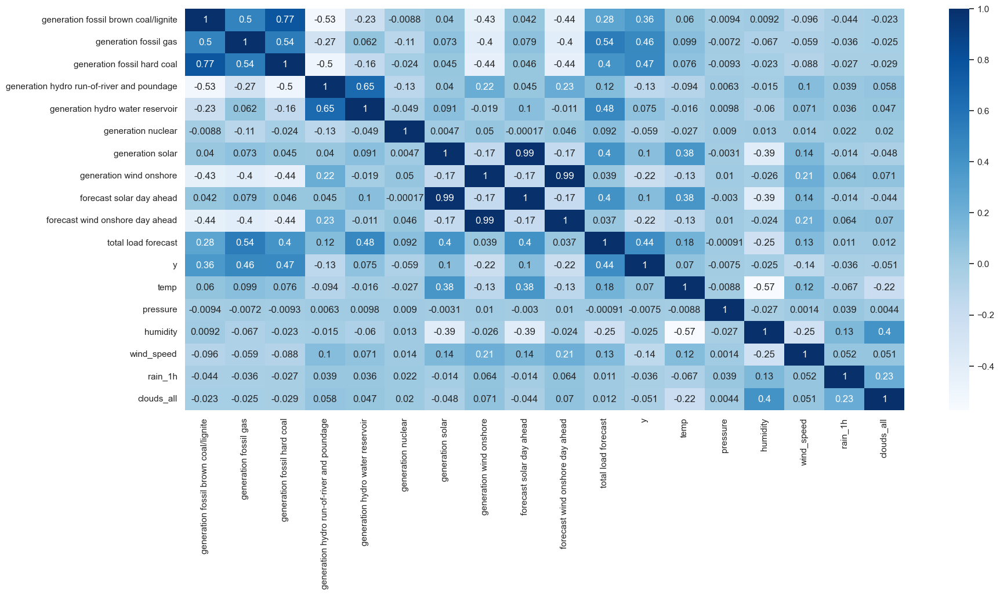

In [207]:
plt.figure(figsize = (20, 9))

sns.heatmap(final_df.corr(numeric_only = True), annot = True, cmap = 'Blues')
plt.show()

In [208]:
final_df.columns

Index(['ds', 'generation fossil brown coal/lignite', 'generation fossil gas',
       'generation fossil hard coal',
       'generation hydro run-of-river and poundage',
       'generation hydro water reservoir', 'generation nuclear',
       'generation solar', 'generation wind onshore',
       'forecast solar day ahead', 'forecast wind onshore day ahead',
       'total load forecast', 'y', 'city_name', 'temp', 'pressure', 'humidity',
       'wind_speed', 'rain_1h', 'clouds_all', 'weather_main'],
      dtype='object')

In [209]:
final_df = final_df.drop(['generation hydro water reservoir', 'pressure', 'humidity', 'forecast solar day ahead', 'forecast wind onshore day ahead',
              'clouds_all'], axis=1)

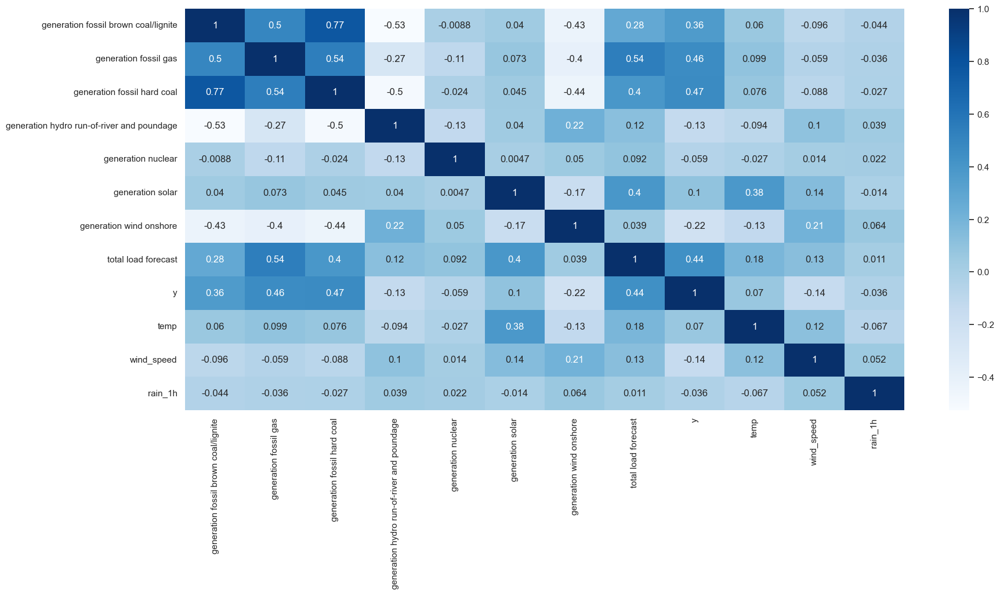

In [210]:
plt.figure(figsize = (20, 9))

sns.heatmap(final_df.corr(numeric_only = True), annot = True, cmap = 'Blues')
plt.show()

🔌 Determinantes do Preço de Energia
Análise de Correlação:

🏭 Fontes Fósseis & Demanda: Apresentam correlação moderada positiva (~0.44 a 0.46), atuando como os principais impulsionadores dos picos de preço observados.

🍃 Fontes Renováveis: Exibem correlação fraca ou negativa, confirmando seu papel crucial como amortecedores de preço no mix energético.

Insight: A dependência de combustíveis fósseis para suprir a demanda máxima explica a volatilidade nos horários de pico.

In [211]:
final_df['weekly_average'] = final_df['y'].rolling(window=24*7, min_periods=1).mean()

#Para a criação de gráfico de gasto com tempo, criado media móvel para diminuição de ruídos 

In [212]:
import plotly.express as px
import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=final_df['ds'], 
    y=final_df['y'],
    mode='lines',
    name='Preço horário',
    line=dict(color="#B1B1B1", width=1),
    hoverinfo='skip',
    opacity=0.3
))
fig.add_trace(go.Scatter(
    x=final_df['ds'], 
    y=final_df['weekly_average'],
    mode='lines',
    name='Tendência (Média Móvel)',
    line=dict(color="#004F9E", width=3)
))
fig.add_annotation(
    x="2017-01-20",
    y=110,
    text="Pico de Inverno: Alta demanda e uso de fósseis",
    showarrow=True,
    arrowhead=2,
    ax=40,
    ay=-40,
    bgcolor="white",
    bordercolor="royalblue"
)
fig.update_layout(
    title={
        'text': "Evolução dos Preços de Energia (2015-2019)",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': dict(size=24)
    },
    plot_bgcolor='white',
    paper_bgcolor='white',
    xaxis=dict(showgrid=False),
    yaxis=dict(gridcolor='#F0F0F0'),
    xaxis_title="Data",
    yaxis_title="Preço Real (€/MWh)",
    template="plotly_white", # Fundo limpo
    hovermode="x unified",    # Mostra os valores de forma organizada ao passar o mouse
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
    ),
    margin=dict(l=50, r=50, t=100, b=50)
)

fig.update_xaxes(rangeslider_visible=True)
fig.show()

📊 Análise de Comportamento Temporal
Observação Principal: Observa-se elevada volatilidade de curto prazo, com picos sazonais estrategicamente associados a:

📈 Demanda Energética: Períodos de consumo pico.

🏭 Mix Energético: Uso intensivo de fontes fósseis (Carvão/Gás).

Nota: A tendência de alta nos picos reflete a sensibilidade do preço ao custo dos combustíveis fósseis.

C:\Users\gui-s\AppData\Local\Temp\ipykernel_6960\3595972413.py:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




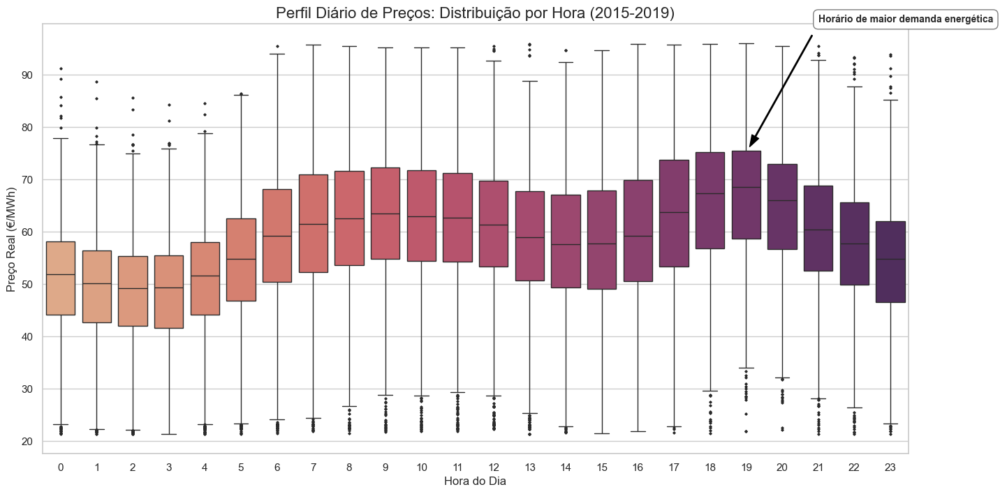

In [213]:
final_df['Hour'] = final_df['ds'].dt.hour

plt.figure(figsize=(16, 8))
sns.set_theme(style="whitegrid")

ax = sns.boxplot(data=final_df, x='Hour', y='y', palette='flare', fliersize=1.5)

ax.annotate('Horário de maior demanda energética', 
            xy=(19, 75),  # Posição da ponta da seta (ajustada para o topo da caixa)
            xytext=(21, 100), # Posição do texto
            arrowprops=dict(facecolor='black', shrink=0.05, width=1, headwidth=8, ec='black'),
            fontsize=10, 
            fontweight='bold',
            bbox=dict(boxstyle="round,pad=0.5", fc="white", ec="gray", lw=1))
plt.title('Perfil Diário de Preços: Distribuição por Hora (2015-2019)', fontsize=16)
plt.xlabel('Hora do Dia', fontsize=12)
plt.ylabel('Preço Real (€/MWh)', fontsize=12)

plt.show()

🕒 Dinâmica Intradiária de Preços
Análise de Ciclo Circadiano:

🌙 Madrugada (00h - 05h): Padrão de estabilidade com preços mínimos, refletindo a baixa carga sistêmica.

📈 Pico Noturno (18h - 21h): Concentração de preços máximos e maior dispersão (volatilidade), impulsionada pelo pico de demanda residencial e comercial.

Conclusão: O comportamento dos preços é um reflexo direto do ciclo de consumo, validando a necessidade de variáveis sazonais horárias no modelo preditivo.

In [214]:
final_df.columns

Index(['ds', 'generation fossil brown coal/lignite', 'generation fossil gas',
       'generation fossil hard coal',
       'generation hydro run-of-river and poundage', 'generation nuclear',
       'generation solar', 'generation wind onshore', 'total load forecast',
       'y', 'city_name', 'temp', 'wind_speed', 'rain_1h', 'weather_main',
       'weekly_average', 'Hour'],
      dtype='object')

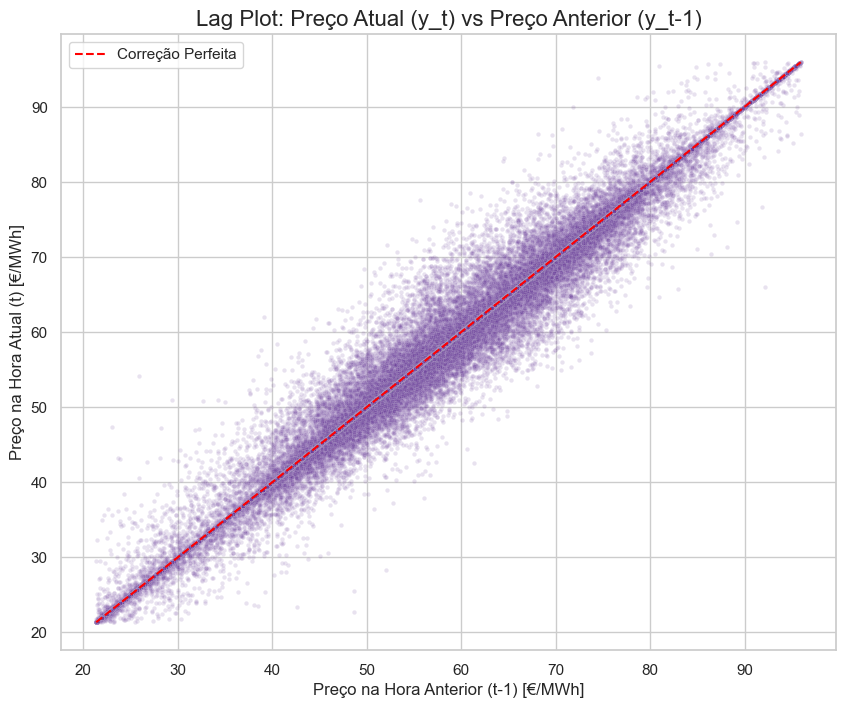

In [215]:
# 1. Criar a variável de lag (t-1)
final_df['y_lag1'] = final_df['y'].shift(1)


plt.figure(figsize=(10, 8))
sns.set_theme(style="whitegrid")


ax = sns.scatterplot(data=final_df, x='y_lag1', y='y', 
                     alpha=0.15,
                     color='#6a3d9a',
                     s=10)

# Se os pontos seguirem esta linha, a correlação é muito alta
plt.plot([final_df['y'].min(), final_df['y'].max()], [final_df['y'].min(), final_df['y'].max()], 
         color='red', linestyle='--', label='Correção Perfeita')

plt.title('Lag Plot: Preço Atual (y_t) vs Preço Anterior (y_t-1)', fontsize=16)
plt.xlabel('Preço na Hora Anterior (t-1) [€/MWh]', fontsize=12)
plt.ylabel('Preço na Hora Atual (t) [€/MWh]', fontsize=12)
plt.legend()

plt.show()

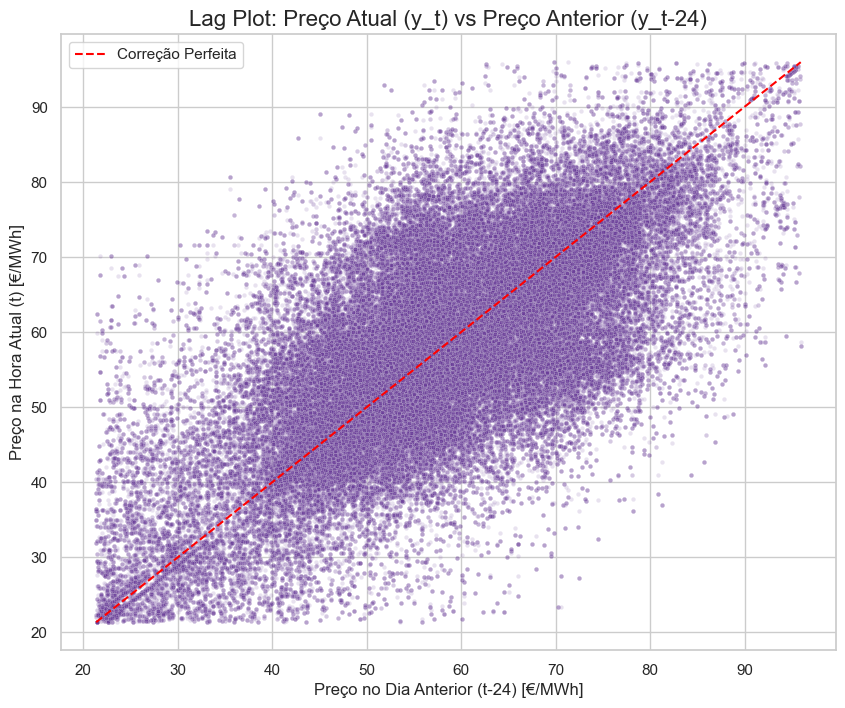

In [216]:
# 1. Criar a variável de lag (t-24)
final_df['y_lag24'] = final_df['y'].shift(24)


plt.figure(figsize=(10, 8))
sns.set_theme(style="whitegrid")


ax = sns.scatterplot(data=final_df, x='y_lag24', y='y', 
                     alpha=0.15,
                     color='#6a3d9a',
                     s=10)

# Se os pontos seguirem esta linha, a correlação é muito alta
plt.plot([final_df['y'].min(), final_df['y'].max()], [final_df['y'].min(), final_df['y'].max()], 
         color='red', linestyle='--', label='Correção Perfeita')

plt.title('Lag Plot: Preço Atual (y_t) vs Preço Anterior (y_t-24)', fontsize=16)
plt.xlabel('Preço no Dia Anterior (t-24) [€/MWh]', fontsize=12)
plt.ylabel('Preço na Hora Atual (t) [€/MWh]', fontsize=12)
plt.legend()

plt.show()

🔄 Inércia de Curto Prazo (Lag 1h)
Insight: O preço atual é "escravo" do passado imediato.

Correlação Linear: A formação em diagonal estreita prova que a melhor estimativa para a próxima hora é o valor da hora atual.

Volatilidade: Pontos que se afastam da diagonal marcam eventos de disrupção súbita no mercado.

Ação: Feature essencial para garantir a estabilidade das previsões do modelo.

📅 Ciclicidade Diária (Lag 24h)
Insight: O preço de hoje "lembra" o preço de ontem.

Sazonalidade Replicada: A nuvem diagonal confirma que os padrões de carga de ontem tendem a se repetir hoje.

Ruído Semanal: A dispersão maior neste gráfico sugere que o modelo também precisará diferenciar dias úteis de finais de semana.

Ação: Feature crítica para o modelo antecipar os picos noturnos com 24h de antecedência.

In [217]:
def get_season(month):
    if month in [12,1,2]:
        return 'Winter'
    if month in [3,4,5]:
        return 'Spring'
    if month in [6,7,8]:
        return 'Summer'
    else:
        return 'Autumn'
    
final_df['season'] = final_df['ds'].dt.month.apply(get_season)

#Criando uma feature de estações do ano

C:\Users\gui-s\AppData\Local\Temp\ipykernel_6960\790948506.py:16: UserWarning:



The `scale` parameter is deprecated and will be removed in v0.15.0. You can now control the size of each plot element using matplotlib `Line2D` parameters (e.g., `linewidth`, `markersize`, etc.).




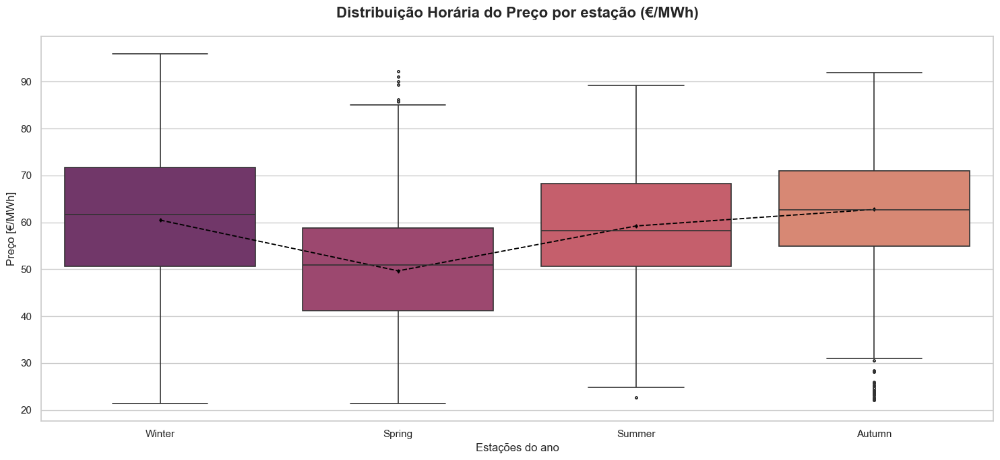

In [218]:

sns.set_theme(style="whitegrid")
plt.figure(figsize=(15, 7))

ax = sns.boxplot(
    data=final_df, 
    x='season', 
    y='y', 
    palette='flare_r', 
    hue='season', 
    legend=False,
    fliersize=2,           
    linewidth=1.2,         
    whis=1.5               
)

sns.pointplot(
    data=final_df, 
    x='season', 
    y='y', 
    color='black', 
    markers='d', 
    linestyles='--', 
    scale=0.5,
    errorbar=None
)


plt.title('Distribuição Horária do Preço por estação (€/MWh)', fontsize=16, fontweight='bold', pad=20)
plt.xlabel('Estações do ano', fontsize=12)
plt.ylabel('Preço [€/MWh]', fontsize=12)

plt.annotate('Pico Noturno', xy=(19, 85), xytext=(21, 100),
             arrowprops=dict(facecolor='black', shrink=0.05, width=1))

plt.annotate('Vale de Madrugada', xy=(4, 40), xytext=(1, 20),
             arrowprops=dict(facecolor='blue', shrink=0.05, width=1))

plt.tight_layout()
plt.show()

❄️ Variabilidade por Estação (Seasonal Boxplot)
Insight: A estação do ano atua como um regulador do patamar médio de preços e da frequência de eventos extremos.

Inverno (Winter): Apresenta a maior amplitude térmica de preços e uma mediana elevada. O alto volume de outliers inferiores indica momentos de forte geração renovável, enquanto os superiores refletem picos de demanda por aquecimento.

Primavera (Spring): É o período de maior estabilidade e preços baixos (menor mediana do conjunto). A "caixa" mais baixa e compacta sugere um equilíbrio favorável entre oferta renovável e demanda moderada.

Verão e Outono (Summer/Autumn): Demonstram uma tendência de recuperação nos preços. O Outono, especificamente, apresenta picos isolados de preço muito agressivos (acima de 110 €/MWh), superando até os picos de inverno.

In [219]:
final_df.groupby('season')['y'].median().sort_values(ascending=False)

season
Autumn    62.73
Winter    61.69
Summer    58.25
Spring    50.97
Name: y, dtype: float64

In [220]:
final_df['is_weekend'] = final_df['ds'].dt.weekday.isin([5, 6]).astype(int)

#Criando uma feature de finais de semana 

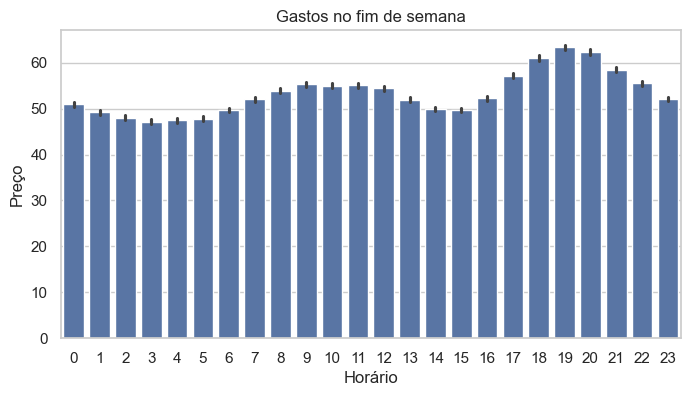

In [221]:
weekend_data = final_df[final_df['is_weekend'] == 1]

price_weekend = weekend_data.groupby('Hour')['y'].sum().reset_index()

plt.figure(figsize = (8, 4))

sns.barplot(data = weekend_data, x = 'Hour', y = 'y')
plt.title("Gastos no fim de semana")
plt.xlabel("Horário")
plt.ylabel("Preço")
plt.show()

In [222]:
data_prophet = final_df.copy()

In [223]:
data_prophet.columns

Index(['ds', 'generation fossil brown coal/lignite', 'generation fossil gas',
       'generation fossil hard coal',
       'generation hydro run-of-river and poundage', 'generation nuclear',
       'generation solar', 'generation wind onshore', 'total load forecast',
       'y', 'city_name', 'temp', 'wind_speed', 'rain_1h', 'weather_main',
       'weekly_average', 'Hour', 'y_lag1', 'y_lag24', 'season', 'is_weekend'],
      dtype='object')

In [224]:
data_prophet = data_prophet.drop(['y_lag1', 'y_lag24', 'city_name', 'Hour', 'weekly_average', 'weather_main'], axis=1)

In [225]:
data_prophet.columns

Index(['ds', 'generation fossil brown coal/lignite', 'generation fossil gas',
       'generation fossil hard coal',
       'generation hydro run-of-river and poundage', 'generation nuclear',
       'generation solar', 'generation wind onshore', 'total load forecast',
       'y', 'temp', 'wind_speed', 'rain_1h', 'season', 'is_weekend'],
      dtype='object')

In [226]:
data_prophet['ds'] = data_prophet['ds'].dt.tz_localize(None)
#Removendo a timezone do datastamp pois o Prophet não aceita

In [227]:
data_prophet.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 178375 entries, 0 to 178374
Data columns (total 15 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   ds                                          178375 non-null  datetime64[ns]
 1   generation fossil brown coal/lignite        178375 non-null  float64       
 2   generation fossil gas                       178375 non-null  float64       
 3   generation fossil hard coal                 178375 non-null  float64       
 4   generation hydro run-of-river and poundage  178375 non-null  float64       
 5   generation nuclear                          178375 non-null  float64       
 6   generation solar                            178375 non-null  float64       
 7   generation wind onshore                     178375 non-null  float64       
 8   total load forecast                         178375 non-null  float64      

In [228]:
from sklearn.preprocessing import OneHotEncoder

cat_col = 'season'

cat_df = data_prophet[[cat_col]]

encoder = OneHotEncoder(handle_unknown='ignore', drop='first')
df_encoded = pd.DataFrame(encoder.fit_transform(cat_df).toarray(), columns=encoder.get_feature_names_out())

In [229]:
final_prophet_df = pd.concat([data_prophet.drop(cat_col, axis=1), df_encoded], axis=1)

In [230]:
final_prophet_df

,ds,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation hydro run-of-river and poundage,generation nuclear,generation solar,generation wind onshore,total load forecast,y,temp,wind_speed,rain_1h,is_weekend,season_Spring,season_Summer,season_Winter
0,2014-12-31 23:00:00,329.0,4844.0,4821.0,1051.0,7096.0,49.0,6378.0,26118.0,65.41,270.475000,1,0.0,0,0.0,0.0,1.0
1,2014-12-31 23:00:00,329.0,4844.0,4821.0,1051.0,7096.0,49.0,6378.0,26118.0,65.41,267.325000,1,0.0,0,0.0,0.0,1.0
2,2014-12-31 23:00:00,329.0,4844.0,4821.0,1051.0,7096.0,49.0,6378.0,26118.0,65.41,269.657312,0,0.0,0,0.0,0.0,1.0
3,2014-12-31 23:00:00,329.0,4844.0,4821.0,1051.0,7096.0,49.0,6378.0,26118.0,65.41,281.625000,7,0.0,0,0.0,0.0,1.0
4,2014-12-31 23:00:00,329.0,4844.0,4821.0,1051.0,7096.0,49.0,6378.0,26118.0,65.41,273.375000,1,0.0,0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178370,2018-12-31 22:00:00,0.0,6926.0,2166.0,1069.0,6075.0,31.0,3651.0,24424.0,69.88,279.140000,2,0.0,0,0.0,0.0,1.0
178371,2018-12-31 22:00:00,0.0,6926.0,2166.0,1069.0,6075.0,31.0,3651.0,24424.0,69.88,275.150000,1,0.0,0,0.0,0.0,1.0
178372,2018-12-31 22:00:00,0.0,6926.0,2166.0,1069.0,6075.0,31.0,3651.0,24424.0,69.88,275.600000,2,0.0,0,0.0,0.0,1.0
178373,2018-12-31 22:00:00,0.0,6926.0,2166.0,1069.0,6075.0,31.0,3651.0,24424.0,69.88,280.130000,5,0.0,0,0.0,0.0,1.0


In [231]:
# Modelo sem os regressores

from prophet import Prophet 

model = Prophet()
model.fit(data_prophet)

future = model.make_future_dataframe(periods=90, freq='D')
predict = model.predict(future)

13:25:57 - cmdstanpy - INFO - Chain [1] start processing
13:29:32 - cmdstanpy - INFO - Chain [1] done processing


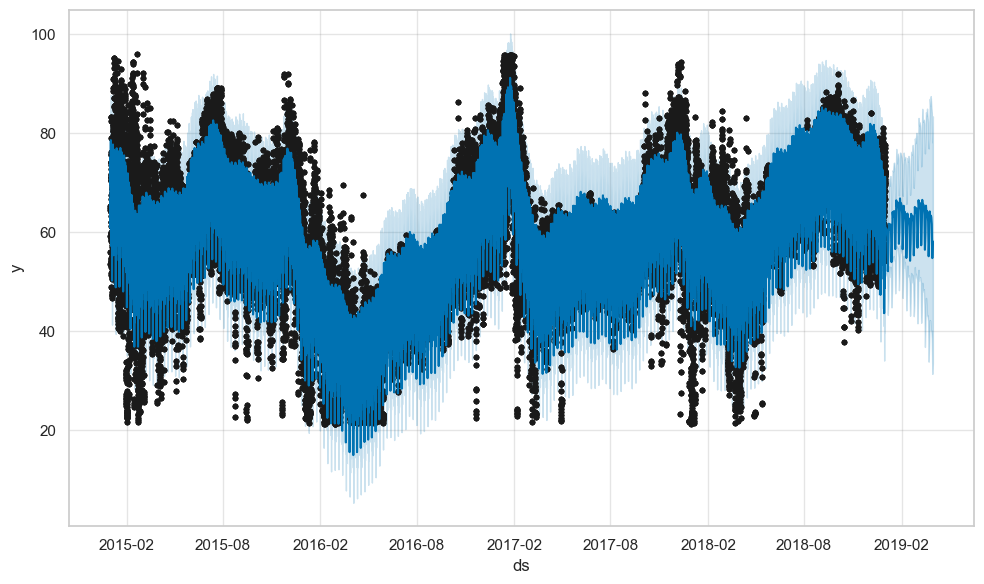

In [232]:
fig1 = model.plot(predict)

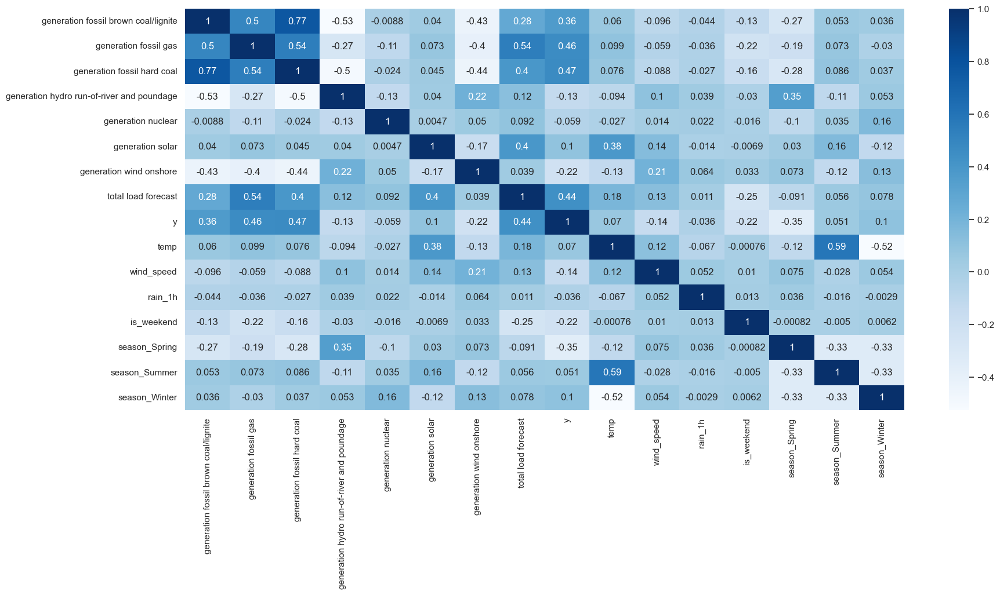

In [233]:
plt.figure(figsize = (20, 9))

sns.heatmap(final_prophet_df.corr(numeric_only = True), annot = True, cmap = 'Blues')
plt.show()

In [234]:
#final_prophet_df = final_prophet_df.drop('generation nuclear', axis=1)
final_prophet_df.columns

Index(['ds', 'generation fossil brown coal/lignite', 'generation fossil gas',
       'generation fossil hard coal',
       'generation hydro run-of-river and poundage', 'generation nuclear',
       'generation solar', 'generation wind onshore', 'total load forecast',
       'y', 'temp', 'wind_speed', 'rain_1h', 'is_weekend', 'season_Spring',
       'season_Summer', 'season_Winter'],
      dtype='object')

In [235]:
final_prophet_df.shape

(178375, 17)

In [236]:
#Separando dados de treino e teste 

#Usando o tail para pegar o bloco final de dados
#Usar muitos valores(anos) pode ter uma dispersão muito grandes nos dados 18240 ~ 2 anos

cut = final_prophet_df.tail(18240).copy()

train_data = cut.iloc[:-720] # Tudo menos os últimos 30 dias
test_data = cut.iloc[-720:]  # Apenas os últimos 30 dias

In [237]:

model = Prophet(daily_seasonality=True, weekly_seasonality=True, yearly_seasonality=True)

regressors = [
    'generation fossil brown coal/lignite', 'generation fossil gas', 
    'generation fossil hard coal', 'generation hydro run-of-river and poundage', 
    'generation solar', 'generation wind onshore', 'total load forecast', 
    'temp', 'wind_speed', 'rain_1h', 'is_weekend', 
    'season_Spring', 'season_Summer', 'season_Winter'
]

for col in regressors:
    model.add_regressor(col)

model.fit(train_data)

forecast = model.predict(test_data)

13:29:43 - cmdstanpy - INFO - Chain [1] start processing
13:30:02 - cmdstanpy - INFO - Chain [1] done processing


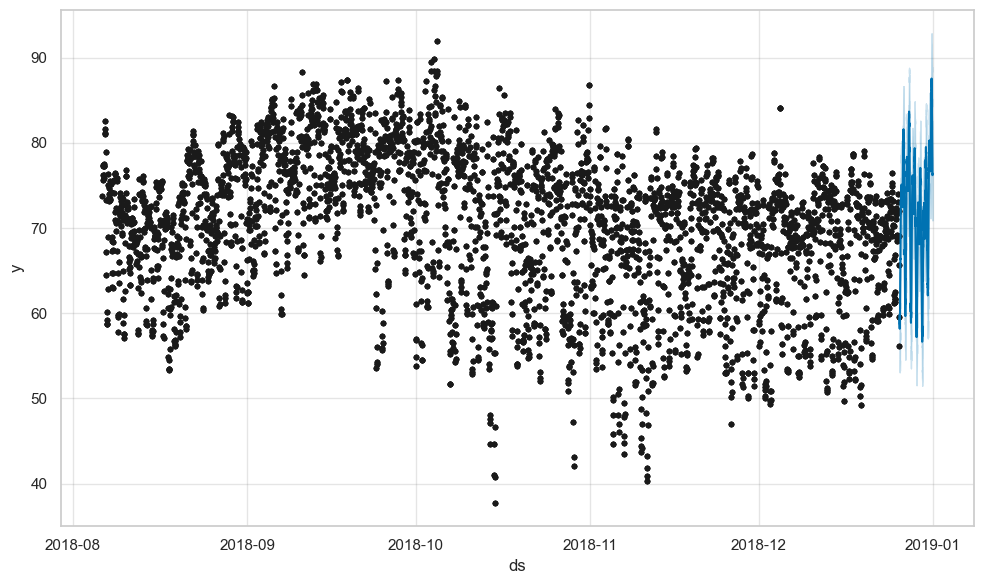

In [238]:
fig1 = model.plot(forecast)

In [245]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]

,ds,yhat,yhat_lower,yhat_upper
0,2018-12-26 01:00:00,59.778735,54.838574,64.833844
1,2018-12-26 02:00:00,58.545588,53.290583,63.543534
2,2018-12-26 02:00:00,58.682234,53.591466,63.760636
3,2018-12-26 02:00:00,58.740914,54.035656,63.529334
4,2018-12-26 02:00:00,58.185614,53.439847,63.647213
...,...,...,...,...
715,2018-12-31 22:00:00,76.753025,71.427840,82.080983
716,2018-12-31 22:00:00,77.063383,71.477726,82.499179
717,2018-12-31 22:00:00,76.876424,71.483691,82.111888
718,2018-12-31 22:00:00,76.204696,70.920129,81.696430


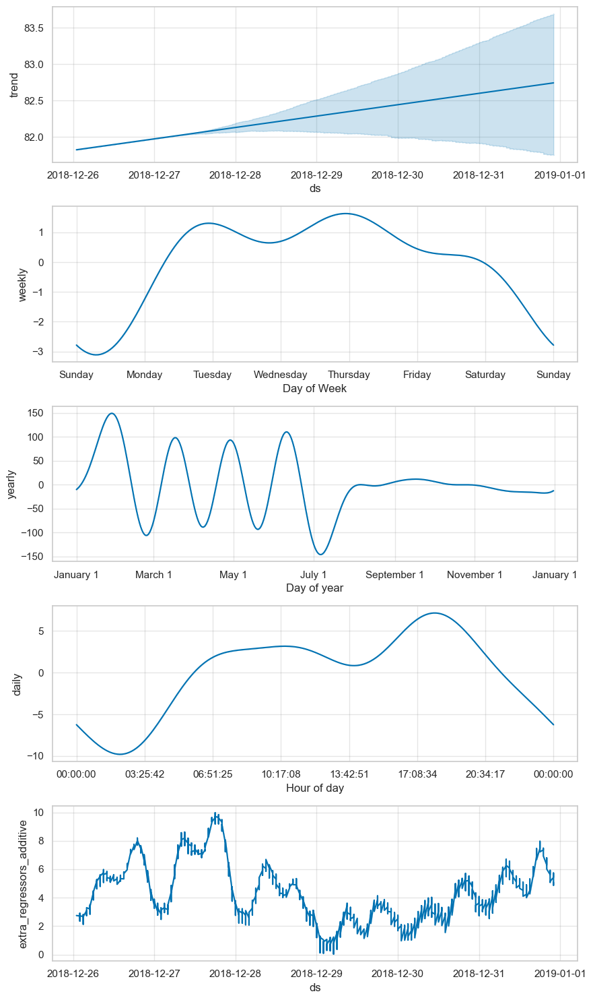

In [242]:
fig2 = model.plot_components(forecast)

In [267]:
data_forecast = forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]
data_comparative = pd.merge(data_forecast, test_data[['ds', 'y']], on='ds')
data_comparative.head()

,ds,yhat,yhat_lower,yhat_upper,y
0,2018-12-26 01:00:00,58.494747,53.216361,63.809103,56.20
1,2018-12-26 02:00:00,57.280629,51.924245,62.550499,54.74
2,2018-12-26 02:00:00,57.280629,51.924245,62.550499,54.74
3,2018-12-26 02:00:00,57.280629,51.924245,62.550499,54.74
4,2018-12-26 02:00:00,57.280629,51.924245,62.550499,54.74


In [251]:
from sklearn.metrics import mean_squared_error

mse = mean_squared_error(data_comparative['y'], data_comparative['yhat'])
rmse = np.sqrt(mse)

print("MSE:", mse)
print("RMSE:", rmse)

MSE: 30.65819027778778
RMSE: 5.536983861073444


In [268]:
data_comparative.duplicated().sum()

np.int64(2960)

In [269]:
data_no_duplicates = data_comparative.drop_duplicates()

In [270]:
data_no_duplicates.duplicated().sum()

np.int64(0)

In [271]:
from sklearn.metrics import mean_squared_error

mse = mean_squared_error(data_no_duplicates['y'], data_no_duplicates['yhat'])
rmse = np.sqrt(mse)

print("MSE:", mse)
print("RMSE:", rmse)

MSE: 15.687709337901994
RMSE: 3.960771305932974


In [261]:
# Cálculo simples: Real - Previsto
data_comparative['residuos'] = data_comparative['y'] - data_comparative['yhat']

# Visualizar as primeiras linhas
print(data_comparative[['ds', 'y', 'yhat', 'residuos']].head())

                   ds      y       yhat  residuos
0 2018-12-26 01:00:00  56.20  59.778735 -3.578735
1 2018-12-26 02:00:00  54.74  58.545588 -3.805588
2 2018-12-26 02:00:00  54.74  58.545588 -3.805588
3 2018-12-26 02:00:00  54.74  58.545588 -3.805588
4 2018-12-26 02:00:00  54.74  58.545588 -3.805588


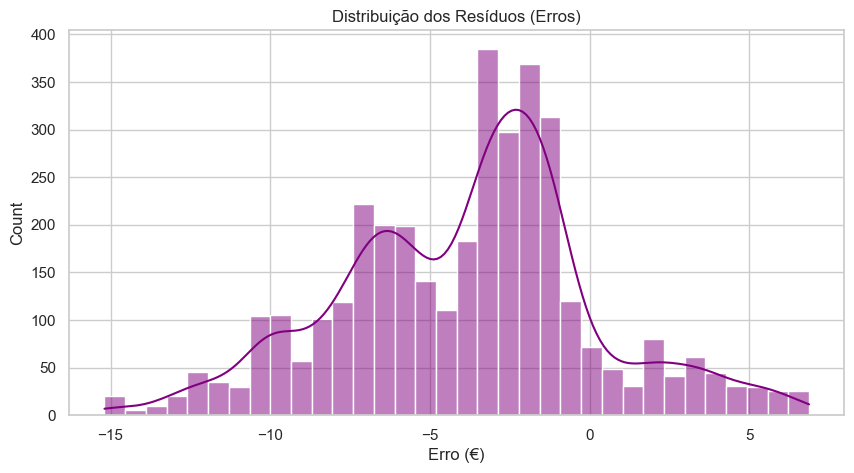

In [262]:
plt.figure(figsize=(10, 5))
sns.histplot(data_comparative['residuos'], kde=True, color='purple')
plt.title('Distribuição dos Resíduos (Erros)')
plt.xlabel('Erro (€)')
plt.show()

In [263]:

model = Prophet(changepoint_prior_scale=0.01, daily_seasonality=True, weekly_seasonality=True, yearly_seasonality=True)

regressors = [
    'generation fossil brown coal/lignite', 'generation fossil gas', 
    'generation fossil hard coal', 'generation hydro run-of-river and poundage', 
    'generation solar', 'generation wind onshore', 'total load forecast', 
    'temp', 'wind_speed', 'rain_1h', 'is_weekend', 
    'season_Spring', 'season_Summer', 'season_Winter'
]

for col in regressors:
    model.add_regressor(col)

model.fit(train_data)

forecast = model.predict(test_data)

14:07:02 - cmdstanpy - INFO - Chain [1] start processing
14:07:09 - cmdstanpy - INFO - Chain [1] done processing


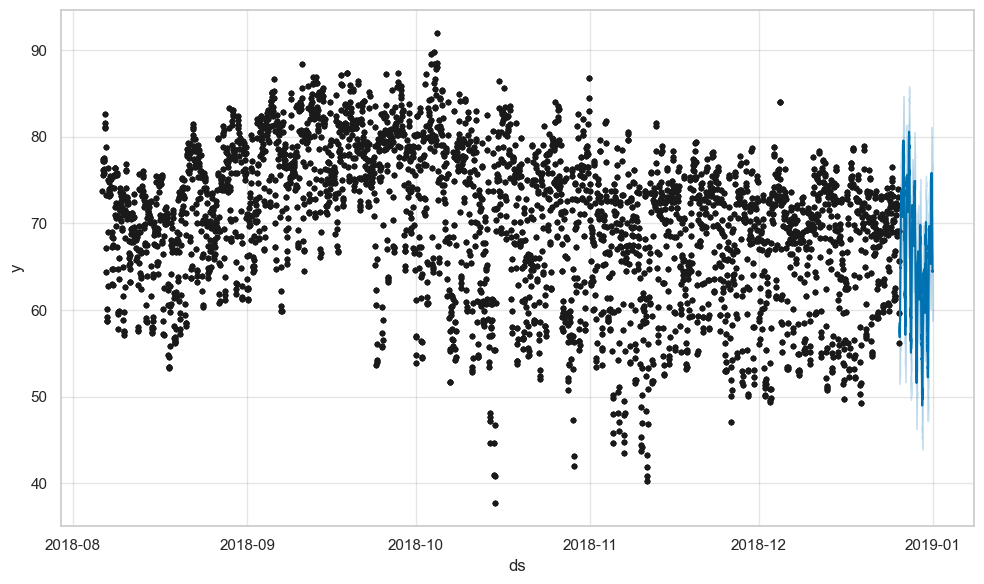

In [265]:
fig1 = model.plot(forecast)

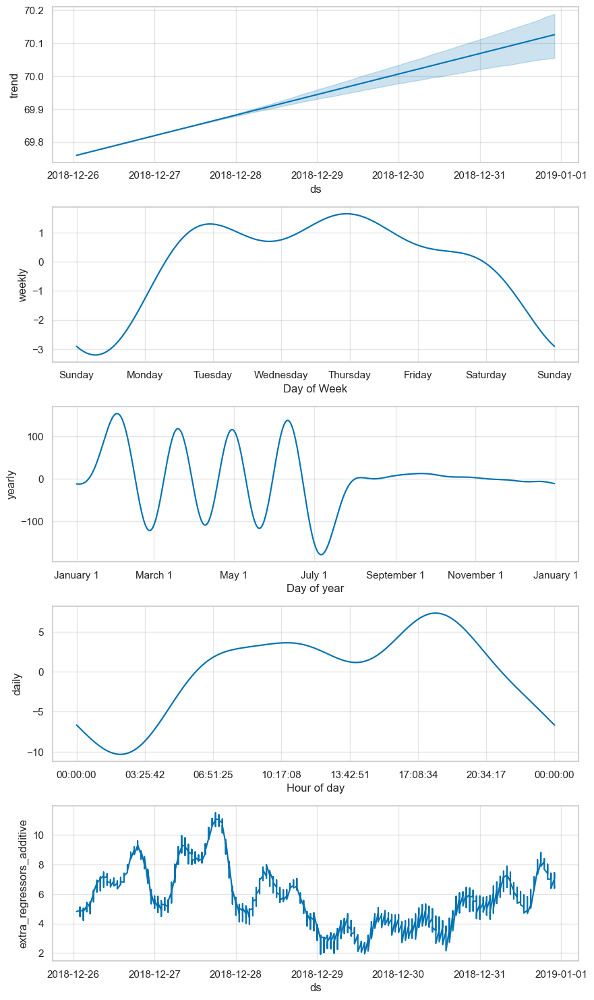

In [266]:
fig2 = model.plot_components(forecast)

In [272]:
mse = mean_squared_error(data_no_duplicates['y'], data_no_duplicates['yhat'])
rmse = np.sqrt(mse)

print("MSE:", mse)
print("RMSE:", rmse)

MSE: 15.687709337901994
RMSE: 3.960771305932974


In [273]:
from prophet.diagnostics import cross_validation, performance_metrics
from prophet.plot import plot_cross_validation_metric

# horizon='24 hours' -> testamos a precisão para um dia inteiro no futuro
# initial='100 days' -> período mínimo de dados para começar o treino
# period='12 hours' -> faz uma nova previsão a cada 12 horas de dados
df_cv = cross_validation(model, initial='100 days', period='12 hours', horizon='24 hours')

# Calcula as métricas (RMSE, MAE, MAPE) para cada horizonte
df_p = performance_metrics(df_cv)
print(df_p.head())

Seasonality has period of 365.25 days which is larger than initial window. Consider increasing initial.


  0%|          | 0/82 [00:00<?, ?it/s]

14:11:53 - cmdstanpy - INFO - Chain [1] start processing
14:11:55 - cmdstanpy - INFO - Chain [1] done processing
14:11:58 - cmdstanpy - INFO - Chain [1] start processing
14:12:00 - cmdstanpy - INFO - Chain [1] done processing
14:12:02 - cmdstanpy - INFO - Chain [1] start processing
14:12:05 - cmdstanpy - INFO - Chain [1] done processing
14:12:07 - cmdstanpy - INFO - Chain [1] start processing
14:12:09 - cmdstanpy - INFO - Chain [1] done processing
14:12:11 - cmdstanpy - INFO - Chain [1] start processing
14:12:14 - cmdstanpy - INFO - Chain [1] done processing
14:12:16 - cmdstanpy - INFO - Chain [1] start processing
14:12:18 - cmdstanpy - INFO - Chain [1] done processing
14:12:20 - cmdstanpy - INFO - Chain [1] start processing
14:12:21 - cmdstanpy - INFO - Chain [1] done processing
14:12:23 - cmdstanpy - INFO - Chain [1] start processing
14:12:26 - cmdstanpy - INFO - Chain [1] done processing
14:12:28 - cmdstanpy - INFO - Chain [1] start processing
14:12:30 - cmdstanpy - INFO - Chain [1]

          horizon        mse      rmse       mae      mape     mdape  \
0 0 days 03:00:00  16.025755  4.003218  3.261972  0.053289  0.045128   
1 0 days 04:00:00  18.636727  4.317028  3.510306  0.055732  0.047158   
2 0 days 05:00:00  21.037926  4.586712  3.674825  0.056277  0.044787   
3 0 days 06:00:00  22.150495  4.706431  3.707852  0.055074  0.045426   
4 0 days 07:00:00  20.181401  4.492371  3.489125  0.050521  0.037660   

      smape  coverage  
0  0.052387  0.817788  
1  0.054367  0.796765  
2  0.054679  0.787550  
3  0.053506  0.788212  
4  0.049460  0.787943  


c:\Users\gui-s\OneDrive\Área de Trabalho\projetos\gasto-total-energia\venv\Lib\site-packages\prophet\plot.py:547: FutureWarning:

Series.view is deprecated and will be removed in a future version. Use ``astype`` as an alternative to change the dtype.

c:\Users\gui-s\OneDrive\Área de Trabalho\projetos\gasto-total-energia\venv\Lib\site-packages\prophet\plot.py:548: FutureWarning:

Series.view is deprecated and will be removed in a future version. Use ``astype`` as an alternative to change the dtype.



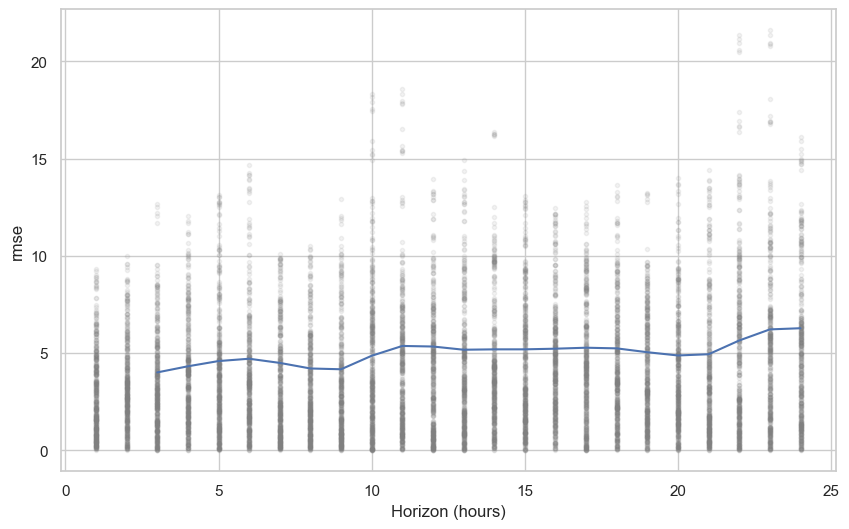

In [274]:
fig3 = plot_cross_validation_metric(df_cv, metric='rmse')

In [275]:
from prophet.plot import plot_plotly

fig = plot_plotly(model, forecast)
fig.show()

In [292]:
future = model.make_future_dataframe(periods=365, freq='h')

last_values = final_prophet_df.tail(365).copy()

novos_dados = pd.DataFrame({
    'ds': future['ds'].tail(365).values,
    'generation fossil brown coal/lignite': last_values['generation fossil brown coal/lignite'].values,
    'generation fossil gas': last_values['generation fossil gas'].values,
    'generation fossil hard coal': last_values['generation fossil hard coal'].values,
    'generation hydro run-of-river and poundage': last_values['generation hydro run-of-river and poundage'].values,
    'generation solar': last_values['generation solar'].values,
    'generation wind onshore': last_values['generation wind onshore'].values,
    'total load forecast': last_values['total load forecast'].values,
    'temp': last_values['temp'].values,
    'wind_speed': last_values['wind_speed'].values,
    'rain_1h': last_values['rain_1h'].values,
    'is_weekend': last_values['is_weekend'].values,
    'season_Spring': last_values['season_Spring'].values,
    'season_Summer': last_values['season_Summer'].values,
    'season_Winter': last_values['season_Winter'].values
})

future_final = future.merge(novos_dados, on='ds', how='left')

In [293]:
future_final = future_final.ffill()
future_final = future_final.bfill()
future_final.head()

,ds,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation hydro run-of-river and poundage,generation solar,generation wind onshore,total load forecast,temp,wind_speed,rain_1h,is_weekend,season_Spring,season_Summer,season_Winter
0,2018-08-06 06:00:00,113.0,5272.0,2067.0,1137.0,15.0,6943.0,25668.0,282.14,2.0,0.0,0.0,0.0,0.0,1.0
1,2018-08-06 07:00:00,113.0,5272.0,2067.0,1137.0,15.0,6943.0,25668.0,282.14,2.0,0.0,0.0,0.0,0.0,1.0
2,2018-08-06 08:00:00,113.0,5272.0,2067.0,1137.0,15.0,6943.0,25668.0,282.14,2.0,0.0,0.0,0.0,0.0,1.0
3,2018-08-06 09:00:00,113.0,5272.0,2067.0,1137.0,15.0,6943.0,25668.0,282.14,2.0,0.0,0.0,0.0,0.0,1.0
4,2018-08-06 10:00:00,113.0,5272.0,2067.0,1137.0,15.0,6943.0,25668.0,282.14,2.0,0.0,0.0,0.0,0.0,1.0


In [294]:
forecast = model.predict(future_final)

fig = plot_plotly(model, forecast)
fig.show()

In [295]:
novos_dados['total load forecast'].max()

np.float64(30619.0)

In [297]:
future_max = future_final.copy()
future_max['total load forecast'] = 30619.0
forecast_max = model.predict(future_max)

future_med = future_final.copy()
future_med['total load forecast'] = 25000.0 # Valor médio típico
forecast_med = model.predict(future_med)

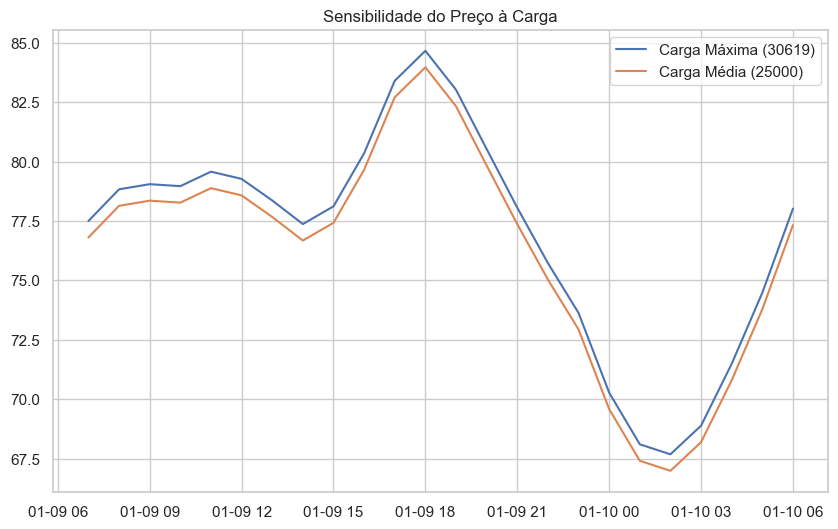

In [298]:
plt.figure(figsize=(10, 6))
plt.plot(forecast_max['ds'].tail(24), forecast_max['yhat'].tail(24), label='Carga Máxima (30619)')
plt.plot(forecast_med['ds'].tail(24), forecast_med['yhat'].tail(24), label='Carga Média (25000)')
plt.legend()
plt.title('Sensibilidade do Preço à Carga')
plt.show()

In [ ]:
filename = 'prophet_model_energy.joblib'

joblib.dump(model, filename)

['prophet_model_energ.joblib']